In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from histograms import fit_pedestal, make_histogram, subtract_pedestal
from file_utils import load_image
from matplotlib.colors import LogNorm
from hit_detection import get_hot_pixels

# Load an image
img = load_image("data/images/image6.npy")
bin_centres, hist_data = make_histogram(img, 100)

# Fit and subtract the pedestal
pedestal_params, _ = fit_pedestal(bin_centres, hist_data)
pedestal_subtracted = subtract_pedestal(img, pedestal_params)


# Double Thresholding

- Define a primary threshold. This is the threshold above which we are confident that a pixel has had a photon hit it. This should probably be just below the peak corresponding to the La/Lb line.

- We then define a second, lower threshold. Possible location could be just above end of noise peak. Pixels between this threshold and the higher one are likely to be due to charge spreading.
    - Both of these thresholds should probably be determined using parts of the image that are not in Bragg peaks, since SPC may not apply there.
    - TODO: does SPC apply in Bragg peaks? What does it mean for SPC to apply in terms of photon density.

- Initially only produce spectrum using primary. Will probably have shit uncertainty.

- Then work on including pixels below primary but above secondary.
    - First, search a 3x3 around each primary. All pixels in that 3x3 that are above the secondary threshold can be included.
    - Second, consider hits that are only due to secondary pixels. Search entire image for all groups of secondary pixels. Hits with only secondaty pixels should be due to charge spreading, so we only include groups that have at least 2 pixels. Sum the values of all pixels in this group: That's a hit.

- We then combine all these hits to produce a spectrum


# Producing the spectra for just one image

In [24]:
from improved_spc import (
    get_raw_primary_hit_values,
    get_adjusted_primary_hit_values,
    get_secondary_hit_values,
)

from improved_spc import locate_primary_threshold, locate_secondary_threshold

def plot_all(primary_sigma, secondary_sigma):

    primary_threshold = locate_primary_threshold(pedestal_subtracted[:, :1200], primary_sigma)
    secondary_threshold = locate_secondary_threshold(pedestal_subtracted, secondary_sigma)

    raw_primaries = get_raw_primary_hit_values(pedestal_subtracted, primary_threshold)
    adjusted_primaries, used_secondaries = get_adjusted_primary_hit_values(
        pedestal_subtracted, primary_threshold, secondary_threshold
    )
    secondaries = get_secondary_hit_values(
        pedestal_subtracted, primary_threshold, secondary_threshold, used_secondaries
    )

    plt.plot(*make_histogram(raw_primaries, -1), label="Raw Primaries")
    plt.plot(*make_histogram(adjusted_primaries, -1), label="Adjusted Primaries", color="red")
    plt.plot(*make_histogram(secondaries, -1), label="Secondaries", color="lime")
    plt.plot(*make_histogram(np.concatenate((secondaries, adjusted_primaries)), -1), label="All", color="black")

    print(len(secondaries)+ len(adjusted_primaries))

    plt.xlim(70, 230)
    plt.legend()
    plt.title(f"Primary sigma, threshold: {primary_sigma}, {primary_threshold:.1f}; Secondary Sigma, threshold: {secondary_sigma}, {secondary_threshold:.1f}")
    plt.show()

9080


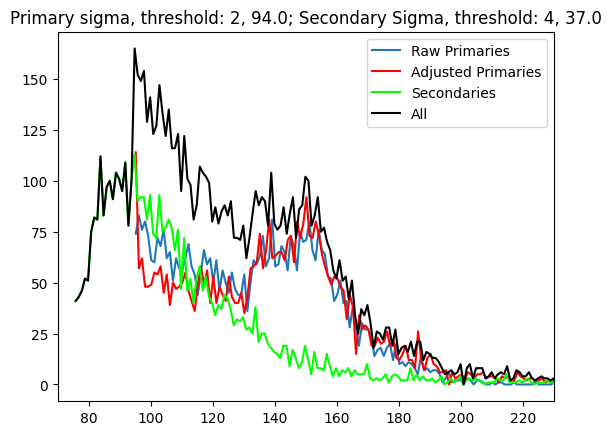

In [25]:
primary_sigma = 2
secondary_sigma = 4


plot_all(primary_sigma, secondary_sigma)



## Comment

This spectra shows 2 peaks, but is very noisy. To do better, we can try combining multiple images' data.

# Combining multiple images

## Getting the beam energies
Before we can combine multiple images, we have to check that the same beam photon energy was used for each image.


Beam energy data is stored in `/Configure:0000/Run:0000/CalibCycle:00XX/Bld::BldDataEBeamV7/EBeam/data` under parameter `fEbeamPhotonEnergy`


In [26]:
import h5py
import itertools
import pandas as pd
f_name = "data/sxro6416-r0504.h5"

datafile = h5py.File(f_name, "r")

data = []

for i in itertools.count(start=0):
    d = datafile.get(f"/Configure:0000/Run:0000/CalibCycle:{i:04d}/Bld::BldDataEBeamV7/EBeam/data")
    
    if d is not None:
        data.append(d[0])
    else:
        break

colnames = eval(str(np.array(data).dtype))
pd.set_option("display.max_columns", None)
pd.DataFrame(np.array(data)).iloc[3:7]


,uDamageMask,fEbeamCharge,fEbeamL3Energy,fEbeamLTUPosX,fEbeamLTUPosY,fEbeamLTUAngX,fEbeamLTUAngY,fEbeamPkCurrBC2,fEbeamEnergyBC2,fEbeamPkCurrBC1,fEbeamEnergyBC1,fEbeamUndPosX,fEbeamUndPosY,fEbeamUndAngX,fEbeamUndAngY,fEbeamXTCAVAmpl,fEbeamXTCAVPhase,fEbeamDumpCharge,fEbeamPhotonEnergy,fEbeamLTU250,fEbeamLTU450
3,0,0.253013,5551.359178,0.047011,-0.011098,0.151146,0.018166,1177.506470,0.046767,213.616547,-0.053797,-0.011518,-0.003375,0.000502,0.000127,84.967743,95.813995,1.186804e+09,1400.144200,-0.031693,-0.004713
4,0,0.245640,5554.029829,0.020456,-0.006098,0.137155,0.020734,1196.580078,0.134568,215.192017,0.033124,-0.008030,0.003328,-0.000551,-0.000053,85.040047,95.912796,1.150184e+09,1401.156774,0.037806,-0.053744
5,0,0.251936,5552.505476,0.061291,-0.010441,0.155477,0.019988,1198.194702,0.098344,213.461807,-0.059136,0.003072,-0.002315,-0.000129,-0.000592,85.024582,95.705894,1.174556e+09,1400.610963,-0.004387,-0.028527
6,0,0.247685,5551.286251,0.038459,-0.010182,0.144493,0.019149,1177.090332,0.225949,209.253830,0.000066,-0.005074,-0.000575,0.000025,0.000166,84.979515,95.848839,1.157817e+09,1399.953255,-0.030682,-0.000182


## Plotting all images
Looks like all beam energies are basically the same. Now, let's see which images have nice clear Bragg lines by plotting them all.

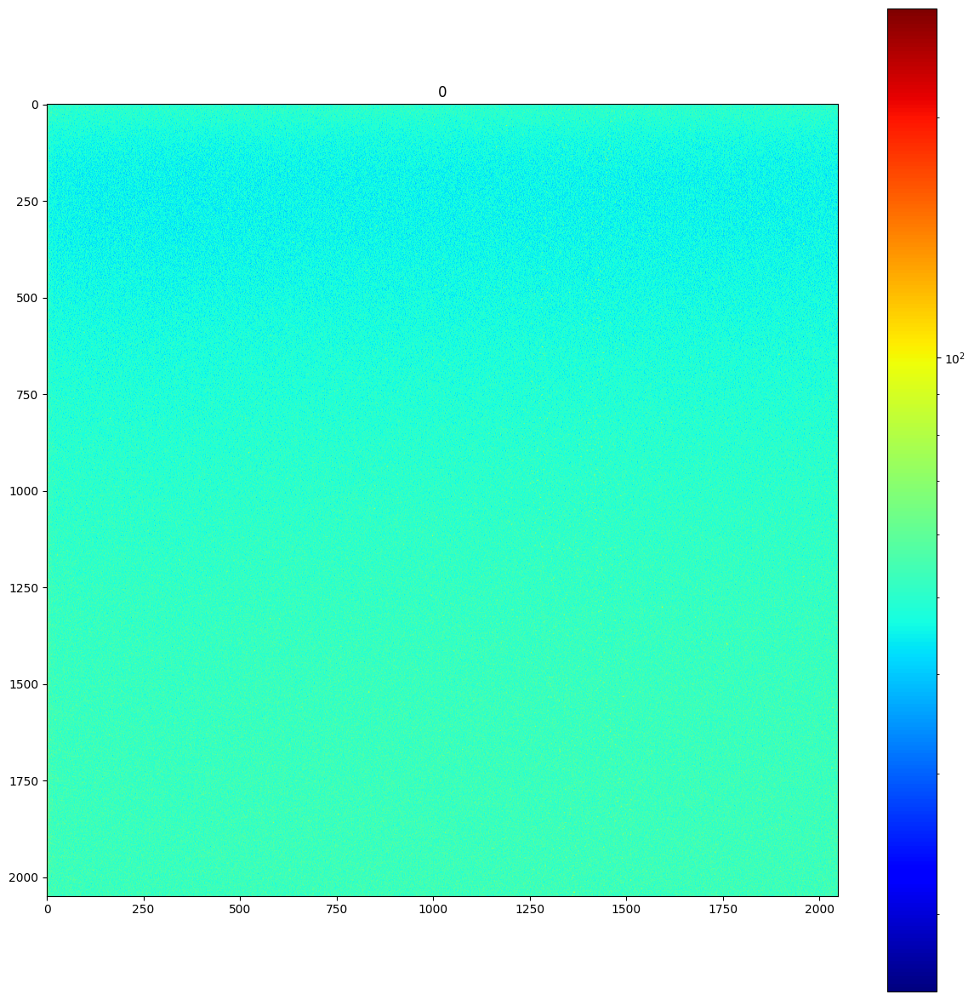

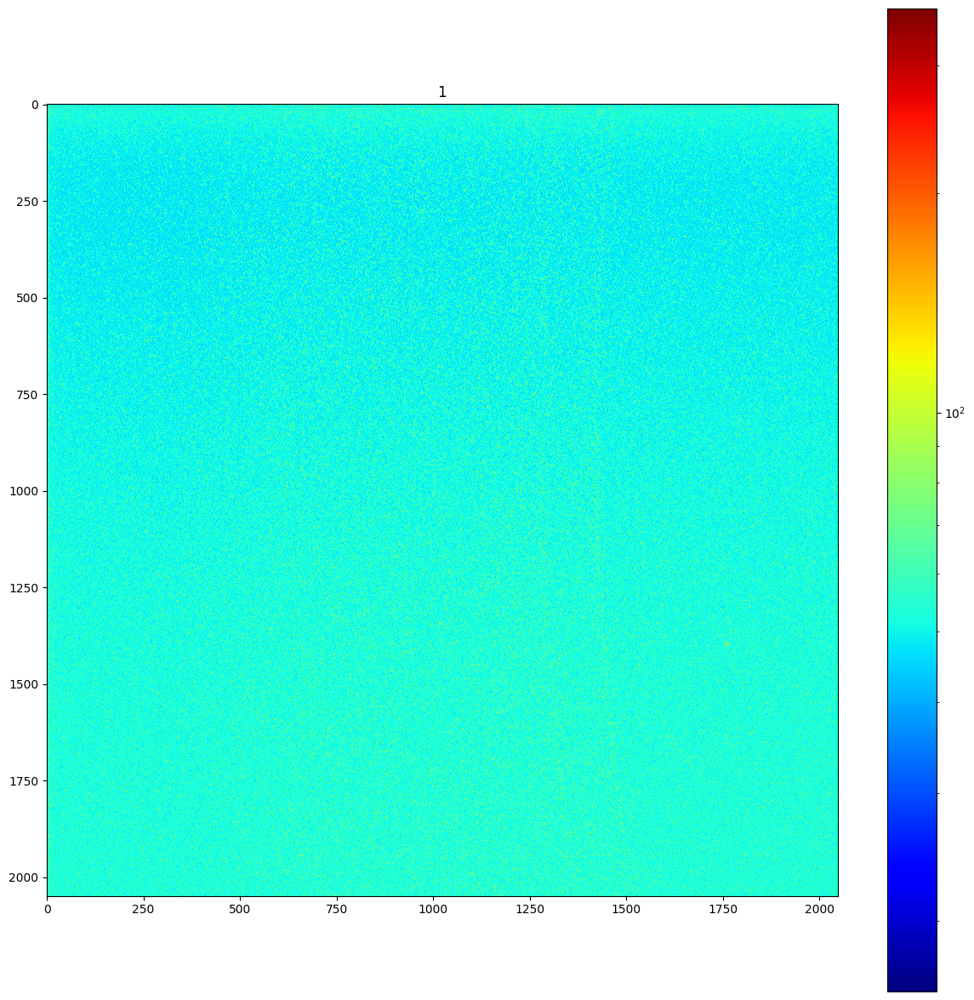

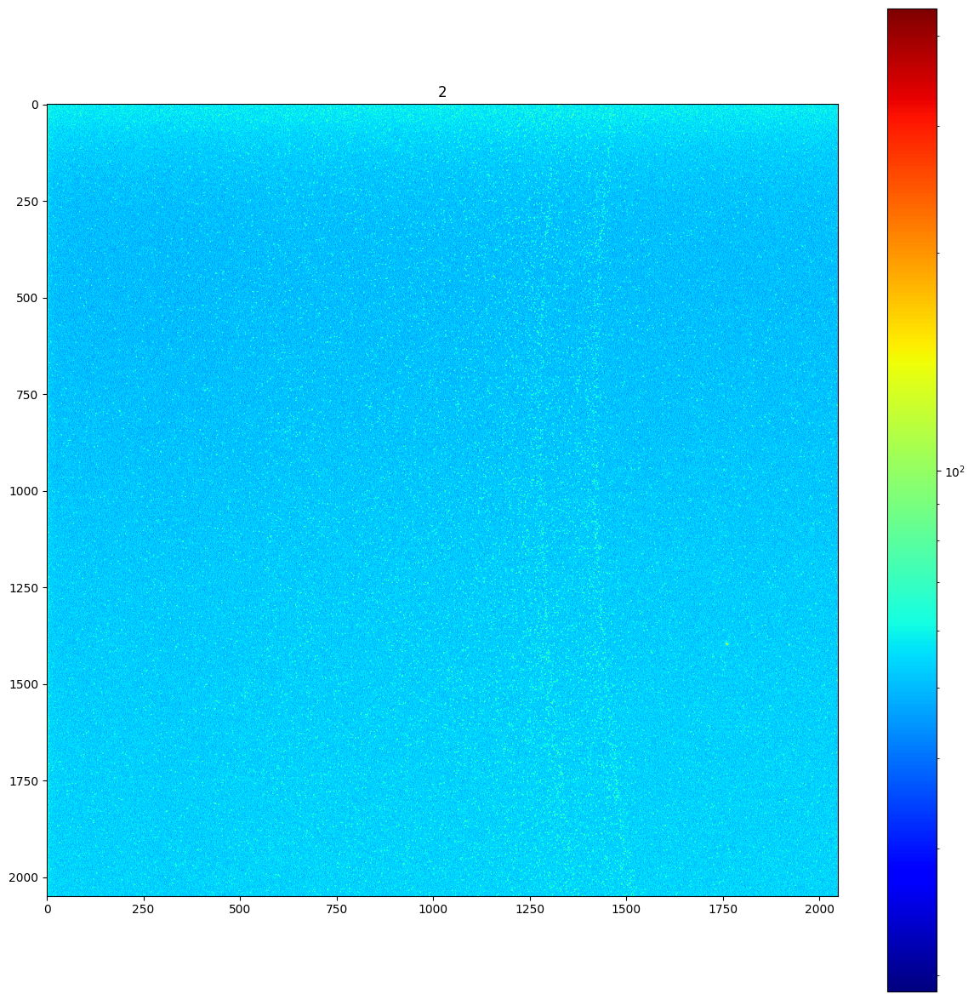

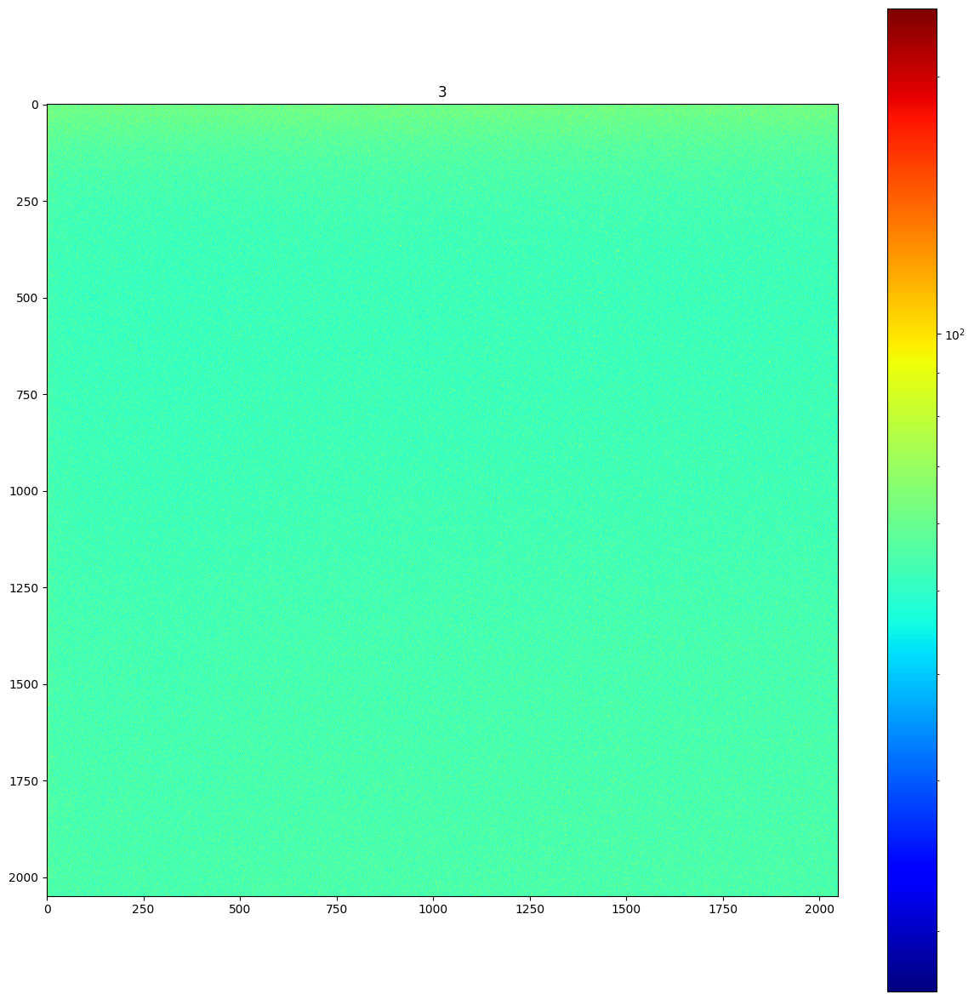

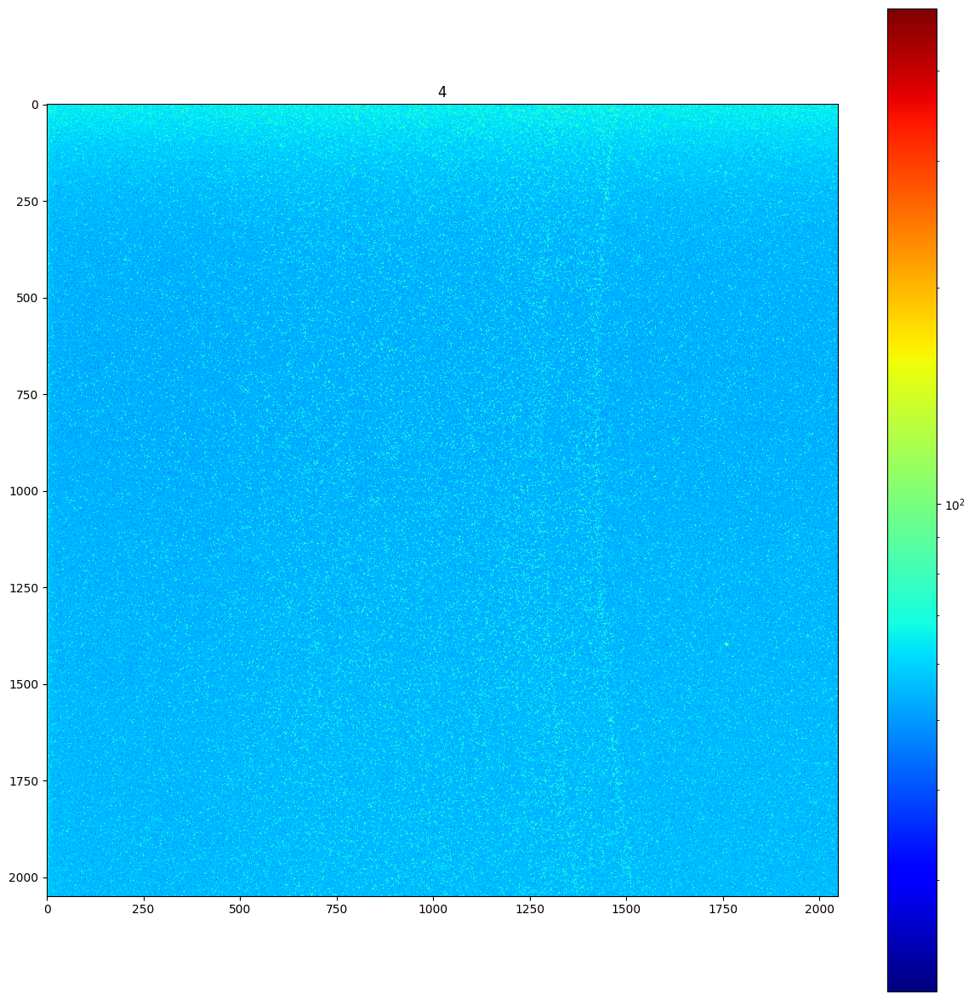

...

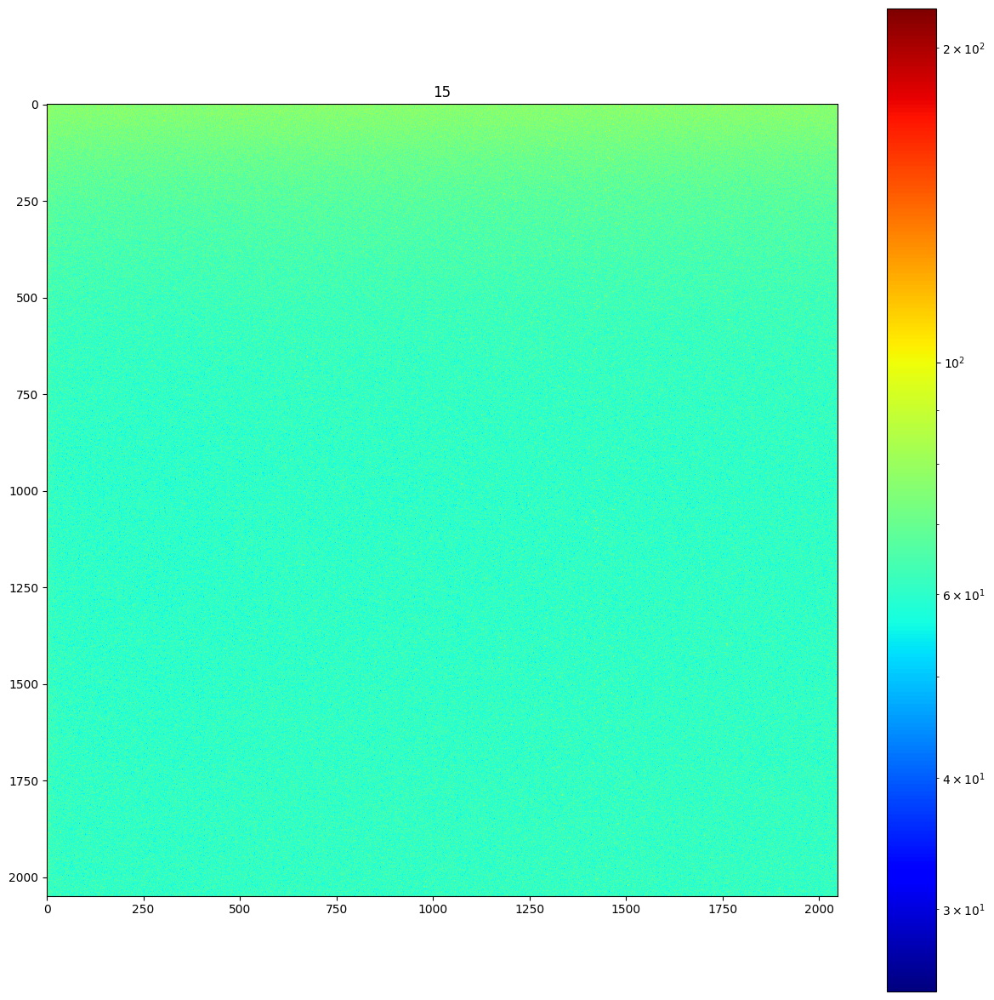

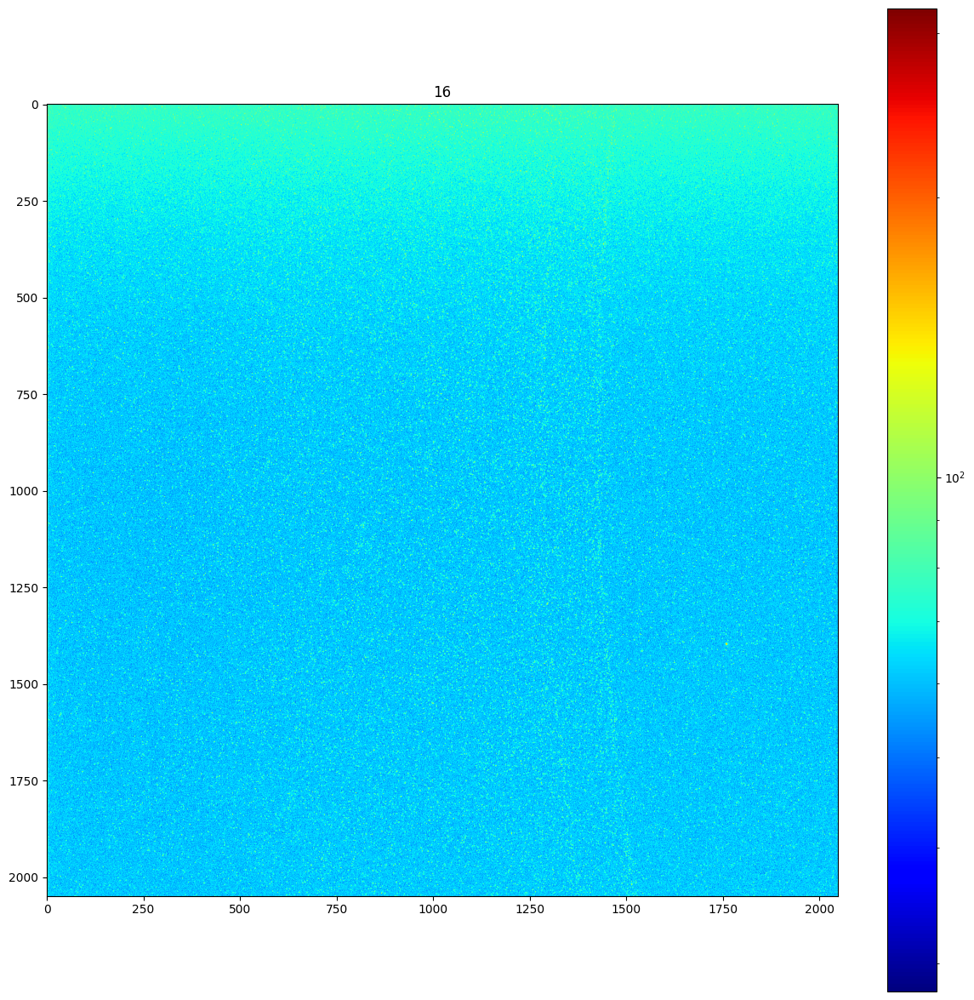

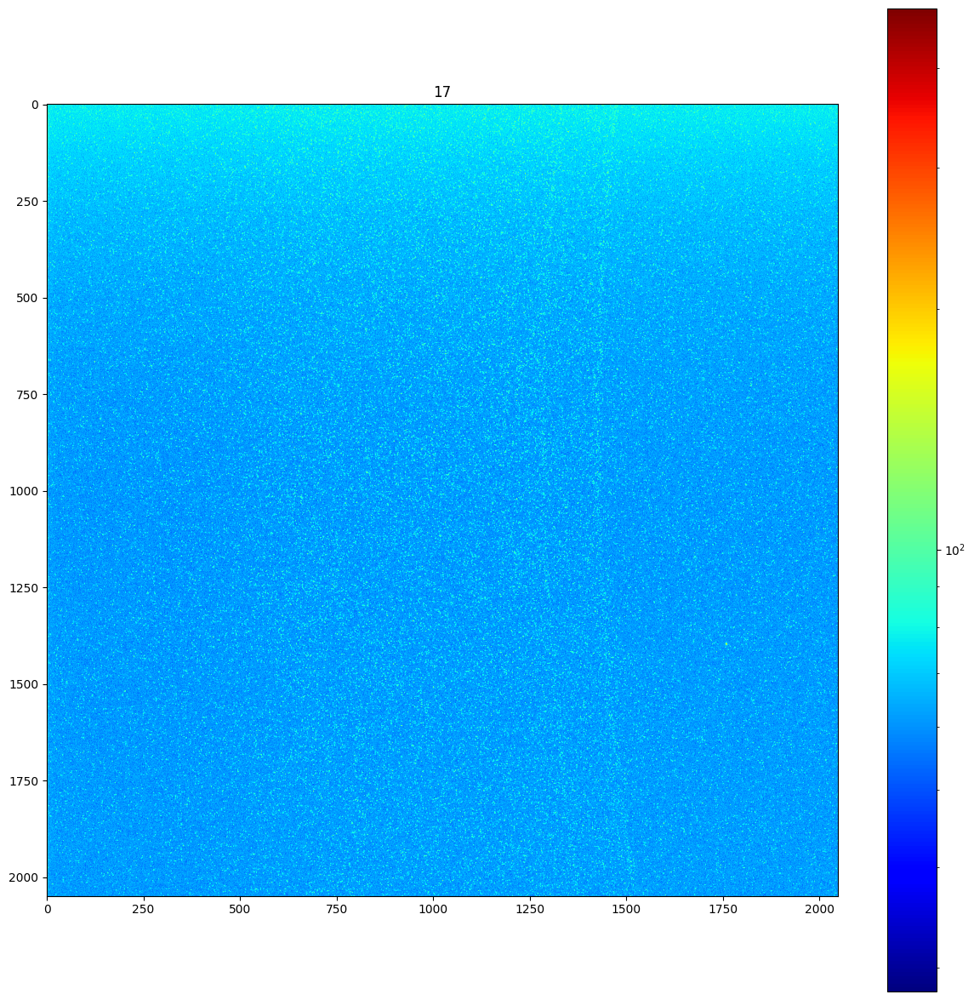

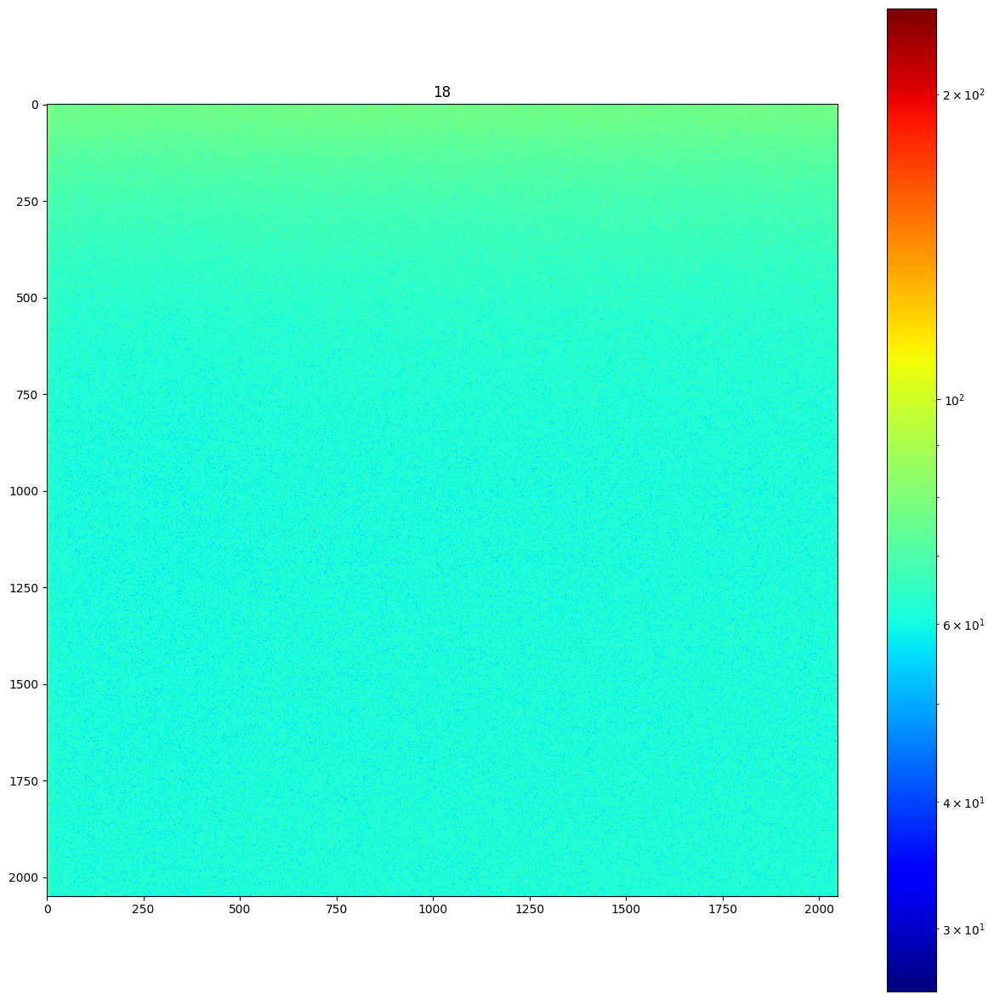

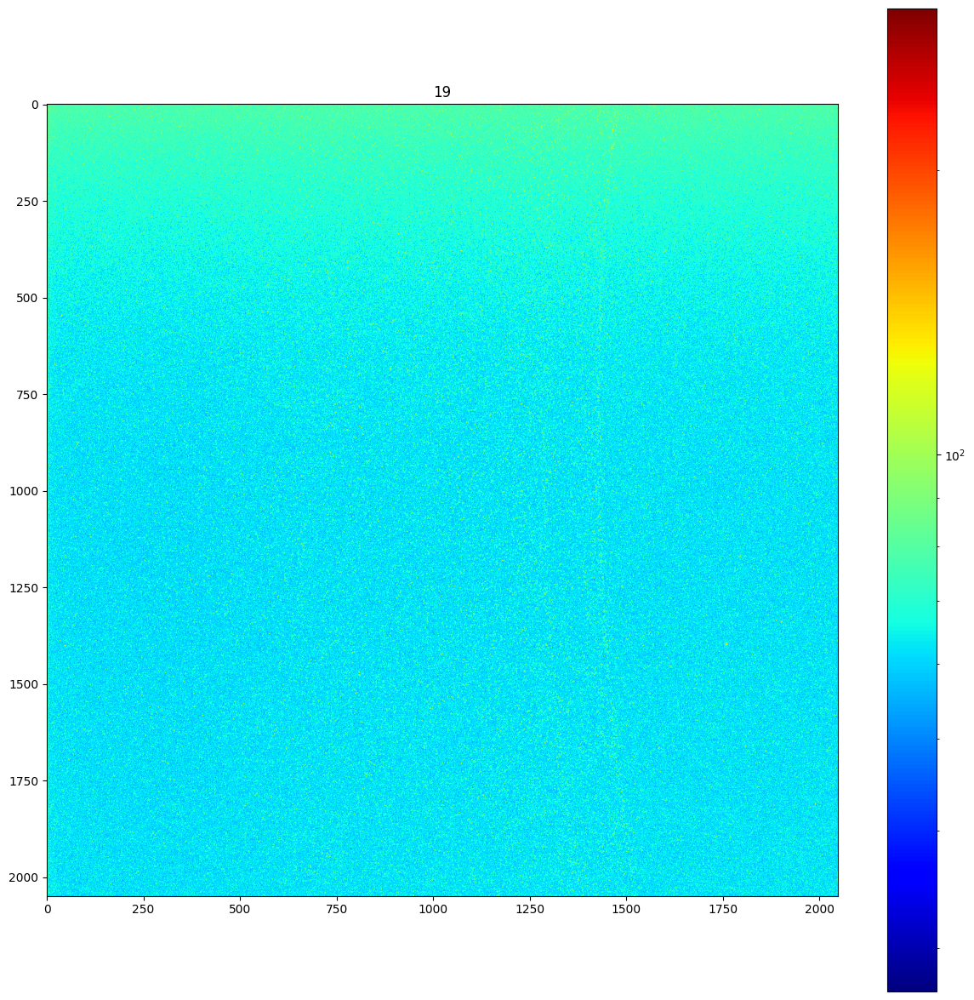

In [27]:
f_name = "data/sxro6416-r0504.h5"


datafile = h5py.File(f_name, "r")
for i in itertools.count(start=0):
    d = datafile.get(
        f"Configure:0000/Run:0000/CalibCycle:{i:04d}/Princeton::FrameV2/SxrEndstation.0:Princeton.0/data"
    )
    if d is not None:
        img_data = d[0]
    else:
        break

    plt.figure(figsize=(15,15))
    plt.imshow(img_data, cmap="jet", norm=LogNorm())
    plt.colorbar()
    plt.title(i)
    plt.show()


## Combining data from multiple spectra

Good spectra seem to be:
- 2, 4, 6, 11, 14, 16, 17, 19
- 7, 8 are not bad either

In [33]:
def get_img_hit_data(pedestal_subtracted, primary_sigma, secondary_sigma):

    primary_threshold = locate_primary_threshold(pedestal_subtracted[:, :1200], primary_sigma)
    secondary_threshold = locate_secondary_threshold(pedestal_subtracted, secondary_sigma)

    # raw_primaries = get_raw_primary_hit_values(pedestal_subtracted, primary_threshold)
    adjusted_primaries, used_secondaries = get_adjusted_primary_hit_values(
        pedestal_subtracted, primary_threshold, secondary_threshold
    )
    secondaries = get_secondary_hit_values(
        pedestal_subtracted, primary_threshold, secondary_threshold, used_secondaries
    )

    return np.concatenate((secondaries, adjusted_primaries))

def load_and_subtract_pedestal(imgno):
    # Load an image
    img = load_image(f"data/images/image{imgno}.npy")
    bin_centres, hist_data = make_histogram(img, 100)

    # Fit and subtract the pedestal
    pedestal_params, _ = fit_pedestal(bin_centres, hist_data)
    return subtract_pedestal(img, pedestal_params)

good_numbers = [2, 4, 6, 11, 14, 16, 17, 19]

def get_all_hits(primary_sigma, secondary_sigma):
    all_hits = np.array([],dtype=np.int64)

    for i in good_numbers:
        img_data = load_and_subtract_pedestal(i)

        img_hits = get_img_hit_data(img_data, primary_sigma, secondary_sigma)

        all_hits = np.concatenate((all_hits, img_hits))
    return all_hits

def plot_all_hits(primary_sigma, secondary_sigma):
    all_hits = get_all_hits(primary_sigma, secondary_sigma)
    plt.plot(*make_histogram(all_hits, -1))
    plt.xlim(0,400)
    plt.title(f"Primary {primary_sigma}, Secondary {secondary_sigma}")
    plt.show()

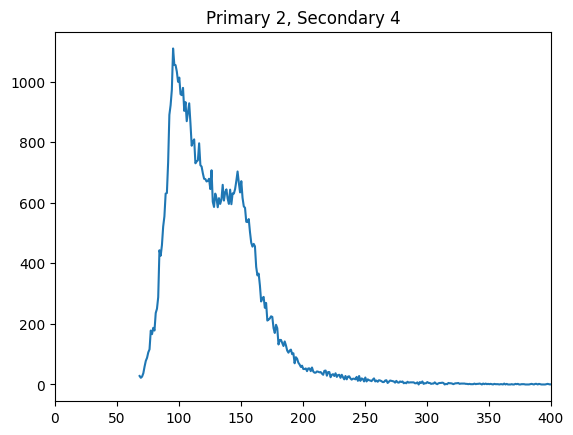

In [8]:
plot_all_hits(2, 4)

This spectrum looks much better.

#### Optimising Parameters

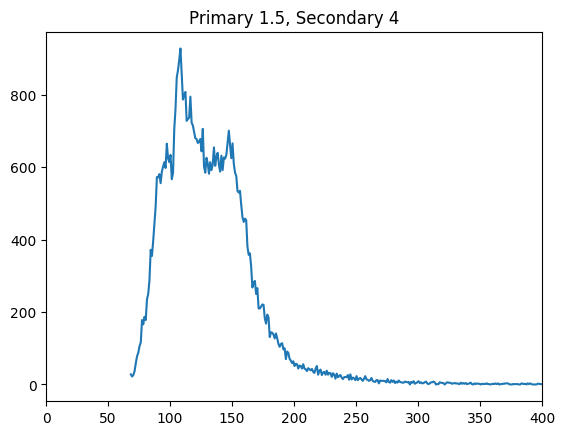

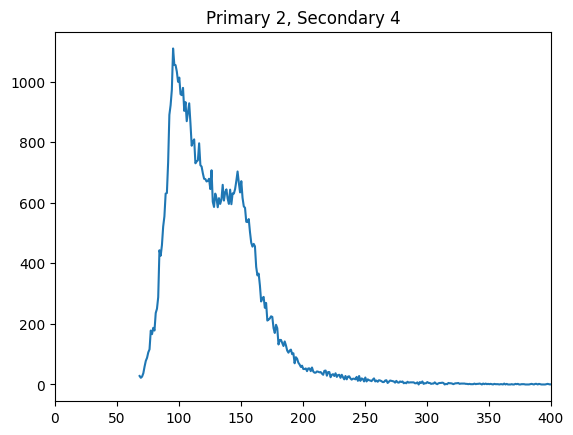

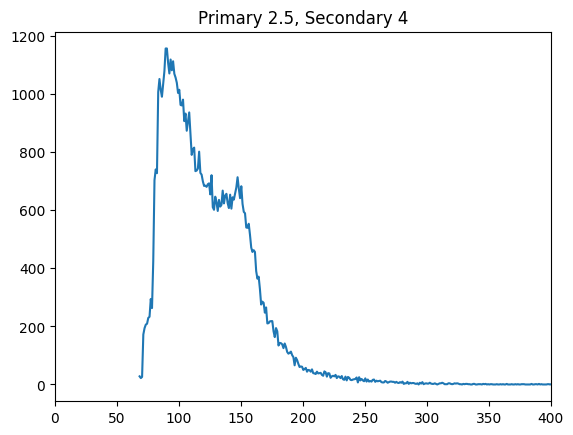

In [9]:
primary_sigmas = [1.5,2,2.5]
secondary_sigmas = [4]

for i in primary_sigmas:
    for j in secondary_sigmas:
        plot_all_hits(i, j)
    

2 looks best, 2.5 is probably second

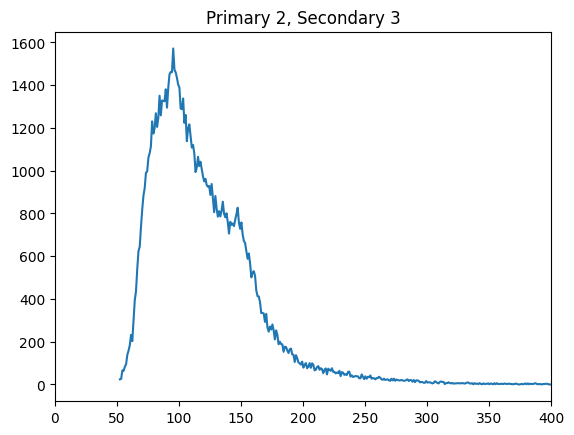

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "c:\Users\jwbar\OneDrive\University\B8\code\env\Lib\site-packages\IPython\core\interactiveshell.py", line 3548, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "C:\Users\jwbar\AppData\Local\Temp\ipykernel_4208\2214937737.py", line 6, in <module>
    plot_all_hits(i, j)
  File "C:\Users\jwbar\AppData\Local\Temp\ipykernel_4208\3017119617.py", line 39, in plot_all_hits
    all_hits = get_all_hits(primary_sigma, secondary_sigma)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jwbar\AppData\Local\Temp\ipykernel_4208\3017119617.py", line 33, in get_all_hits
    img_hits = get_img_hit_data(img_data, primary_sigma, secondary_sigma)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jwbar\AppData\Local\Temp\ipykernel_4208\3017119617.py", line 10, in get_img_hit_data
    secondaries = get_secondary_hit_values(
                  ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "

In [10]:
primary_sigmas = [2]
secondary_sigmas = [3, 4, 5]

for i in primary_sigmas:
    for j in secondary_sigmas:
        plot_all_hits(i, j)
    

5 definitely too high, 4 better than 3

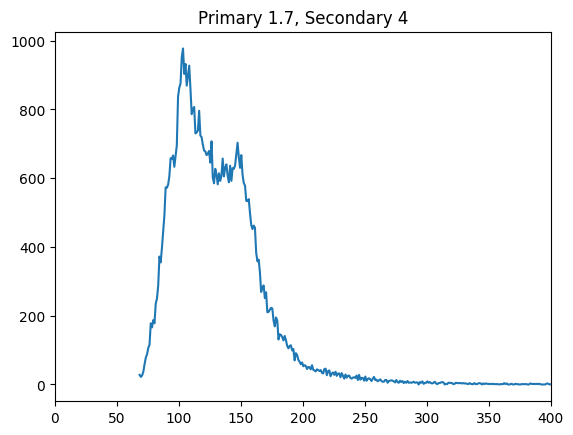

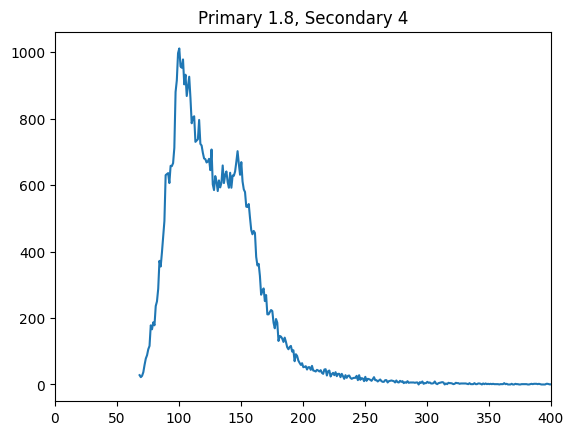

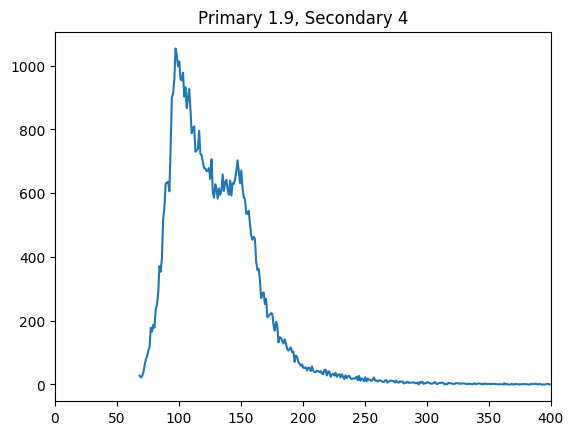

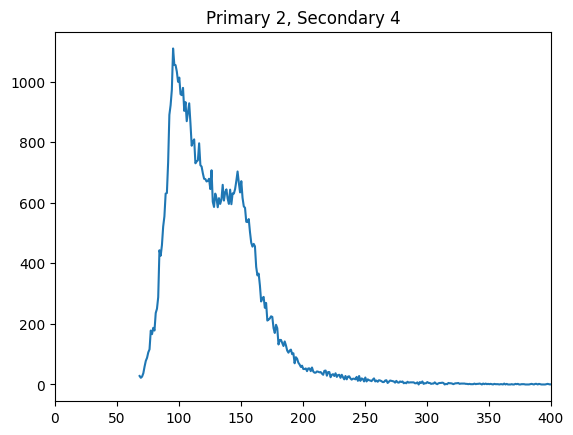

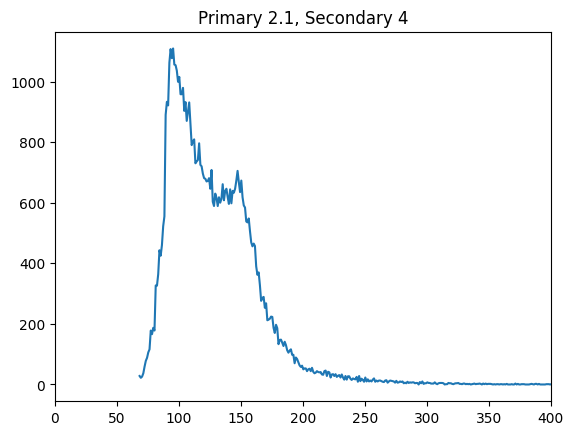

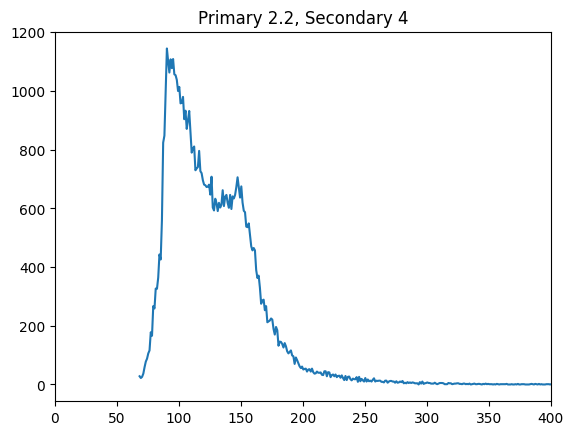

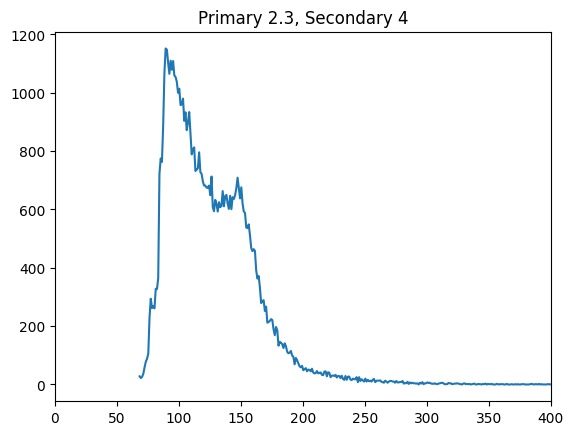

In [ ]:
primary_sigmas = [1.7, 1.8, 1.9,2,2.1, 2.2, 2.3]
secondary_sigmas = [4]

for i in primary_sigmas:
    for j in secondary_sigmas:
        plot_all_hits(i, j)
    

# Scope for improvements to this:

- We could weight images' contribution to the spectum based off of their own signal-to-noise ratios.
- Improve noise removal using dark images, or pixel-by-pixel bias considerations
    - Pixel-by-pixel may be an issue, since Bragg lines cause problems
    - For dark images, it may be worth considering exposure times of the CCD. This may be worth considering in general as well.


# Dark images

## Looking at histograms
Dark images should be immediately identifiable by having no signal component to their histogram

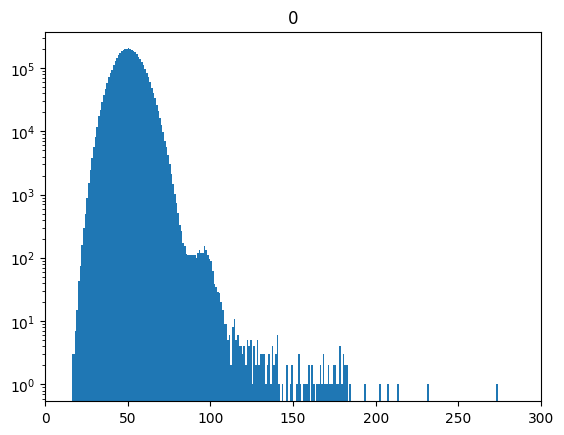

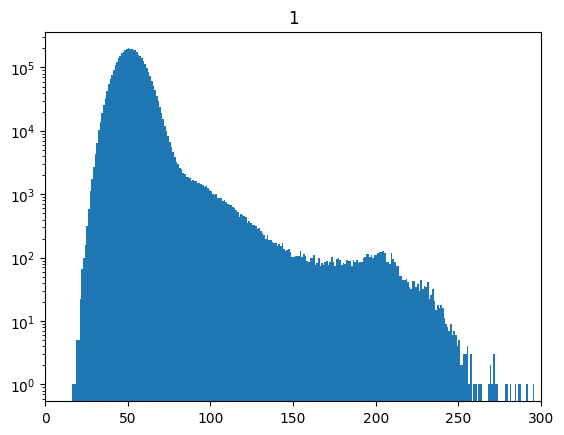

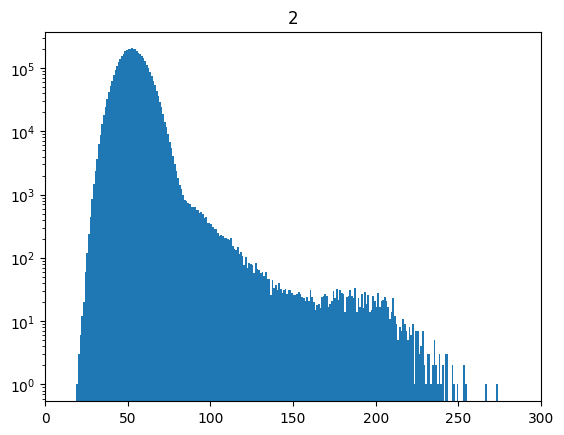

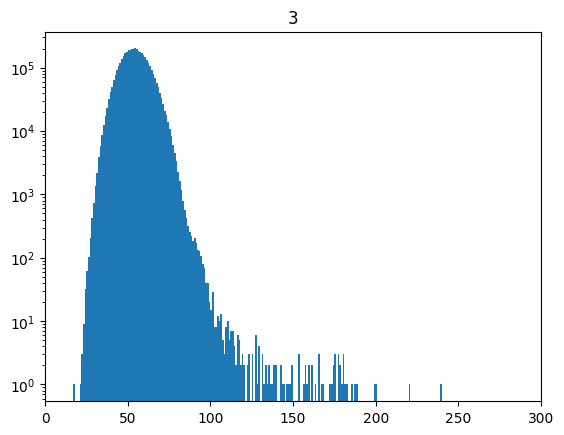

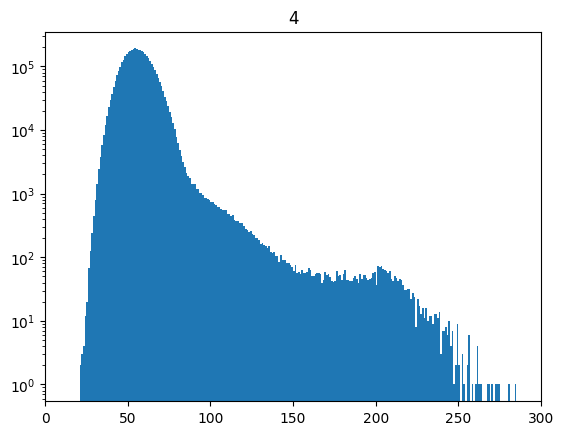

...

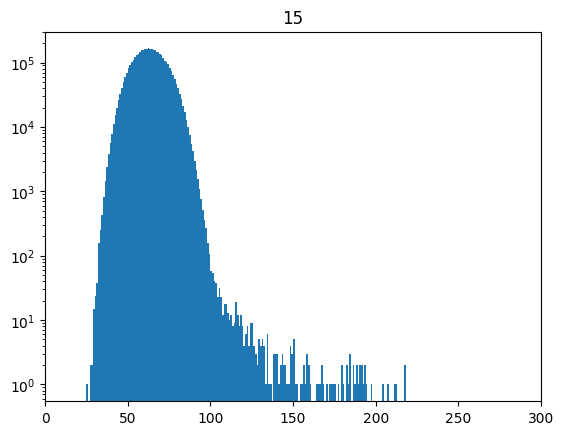

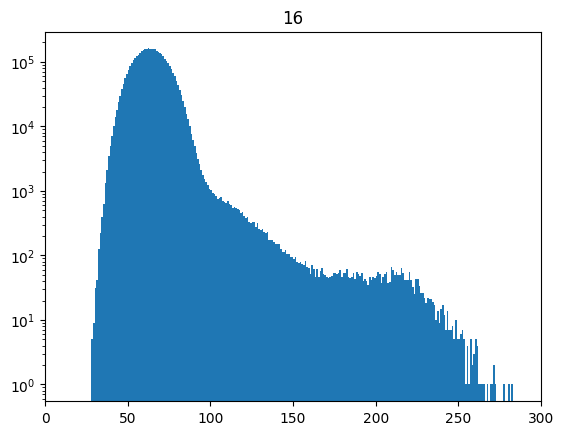

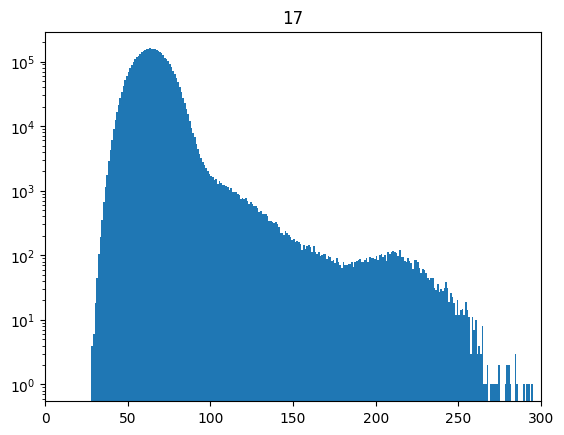

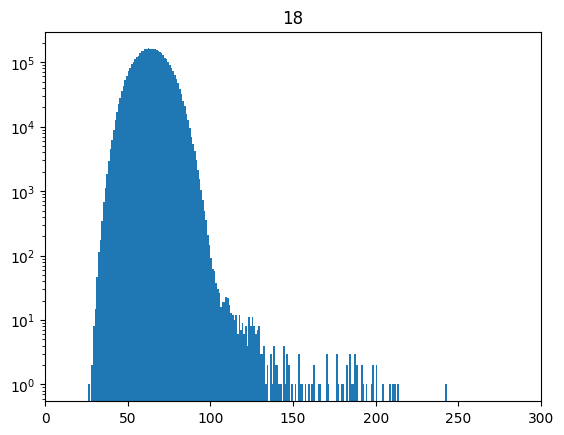

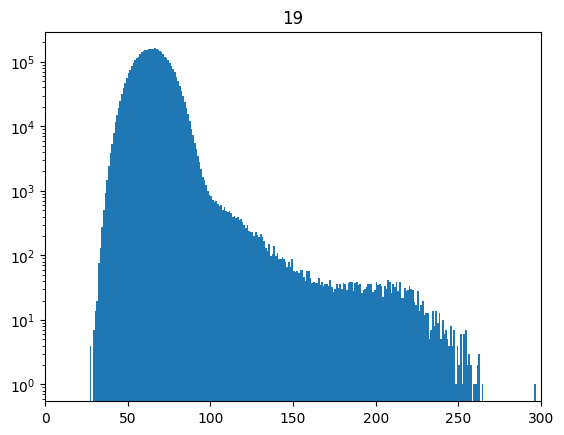

In [11]:
from file_utils import load_image
for i in range(20):
    img_data = load_image(f"data/images/image{i}.npy")
    bin_centres, hist_data = make_histogram(img_data, -1)
    plt.bar(bin_centres, hist_data, bin_centres[1]-bin_centres[0])

    plt.title(i)
    plt.yscale("log")
    plt.xlim(0,300)
    plt.show()

## Conculsions from these histograms

Signal images: 1, 2, 4, 6, 7, 8, 11, 14, 16, 17, 19
Dark images: 3, 5, 9, 10, 12, 13, 15, 18
Image 0 looks like it should be dark, but has more signal than I'm comfortable with, so I'll leave it out of the analysis.

## Creating a master dark

We can average the intensities at each pixel over the dark images to create a "master dark"

In [28]:
dark_image_numbers = [3, 5, 9, 10, 12, 13, 15, 18]

dark_images = np.array([load_image(f"data/images/image{i}.npy") for i in dark_image_numbers])

dark_images.shape



(8, 2048, 2048)

In [29]:
master_dark = np.mean(dark_images, axis = 0)
np.save("data/master_dark.npy", master_dark)


Text(0.5, 1.0, 'Master Dark')

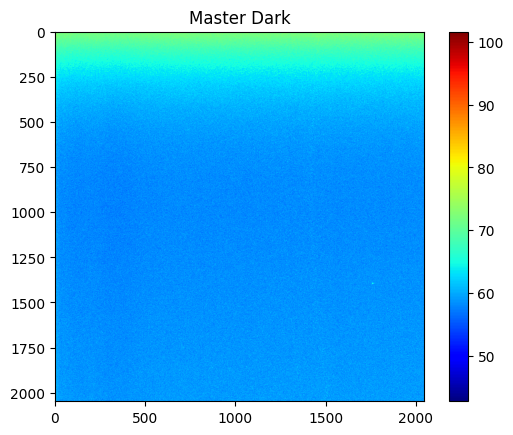

In [5]:
%matplotlib inline
master_dark = np.load("data/master_dark.npy")
plt.imshow(master_dark, cmap="jet")
plt.colorbar()
plt.title("Master Dark")

There is some feint trace of a bragg line. It is, however, significantly below the expected intensity for a Bragg line, so I will ignore it for now.

## Using a dark image to remove noise

In [7]:
%matplotlib inline
from histograms import load_and_subtract_pedestal
from improved_spc import get_img_hit_data, locate_primary_threshold, locate_secondary_threshold, get_adjusted_primary_hit_values


def load_and_subtract_dark(imgno):
    # Load an image
    img = load_image(f"data/images/image{imgno}.npy")
    return img-master_dark

def get_all_hits_pr(primary_sigma, secondary_sigma, include_secondaries = True, adjust_primaries = True):
    all_hits = np.array([],dtype=np.int64)

    for i in good_numbers:
        img_data = load_and_subtract_pedestal(i)

        img_hits = get_img_hit_data(img_data, primary_sigma, secondary_sigma, include_secondaries, adjust_primaries)

        all_hits = np.concatenate((all_hits, img_hits))
    return all_hits

def get_all_hits_dr(primary_sigma, secondary_sigma, include_secondaries = True, adjust_primaries = True):
    all_hits = np.array([],dtype=np.int64)

    for i in good_numbers:
        img_data = load_and_subtract_dark(i)

        img_hits = get_img_hit_data(img_data, primary_sigma, secondary_sigma, include_secondaries, adjust_primaries)

        all_hits = np.concatenate((all_hits, img_hits))
    return all_hits

(0.0, 300.0)

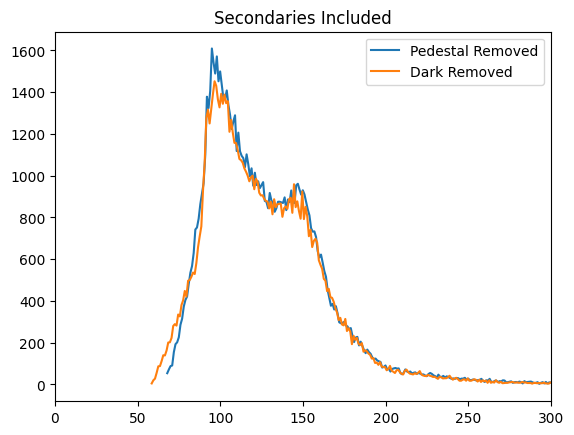

In [6]:
good_numbers = [1, 2, 4, 6, 7, 8, 11, 14, 16, 17, 19]
primary_sigma = 2
secondary_sigma = 4
pr_spectrum = get_all_hits_pr(primary_sigma, secondary_sigma, True, True)
plt.plot(*make_histogram(pr_spectrum, -1), label = "Pedestal Removed")

dr_spectrum = get_all_hits_dr(primary_sigma, secondary_sigma, True, True)
plt.plot(*make_histogram(dr_spectrum, -1), label = "Dark Removed")

plt.legend()
plt.title("Secondaries Included, Primaries Adjusted")
plt.xlim(0,300)

(0.0, 300.0)

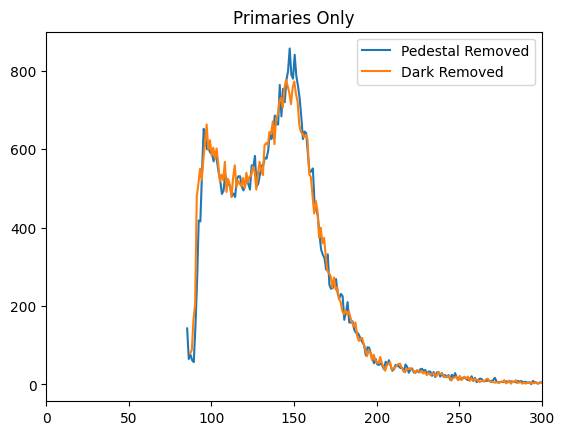

In [7]:
pr_spectrum = get_all_hits_pr(primary_sigma, secondary_sigma, False, True)
plt.plot(*make_histogram(pr_spectrum, -1), label = "Pedestal Removed")

dr_spectrum = get_all_hits_dr(primary_sigma, secondary_sigma, False, True)
plt.plot(*make_histogram(dr_spectrum, -1), label = "Dark Removed")

plt.legend()
plt.title("Primaries Only, adjusted")
plt.xlim(0,300)

(0.0, 300.0)

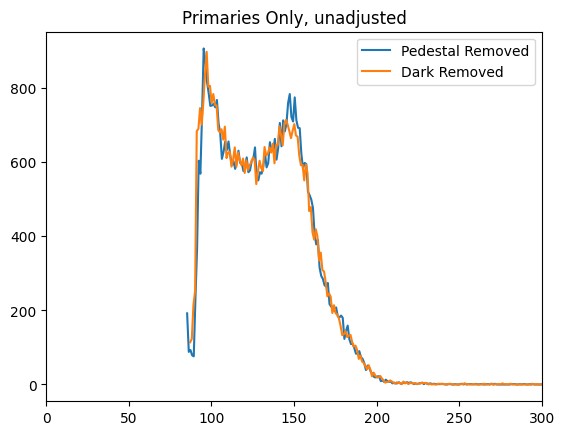

In [8]:
good_numbers = [1, 2, 4, 6, 7, 8, 11, 14, 16, 17, 19]
primary_sigma = 2
secondary_sigma = 4

pr_spectrum = get_all_hits_pr(primary_sigma, secondary_sigma, False, False)
plt.plot(*make_histogram(pr_spectrum, -1), label = "Pedestal Removed")

dr_spectrum = get_all_hits_dr(primary_sigma, secondary_sigma, False, False)
plt.plot(*make_histogram(dr_spectrum, -1), label = "Dark Removed")


plt.legend()
plt.title("Primaries Only, unadjusted")
plt.xlim(0,300)

## How does dark image subtraction affect the image histogram?

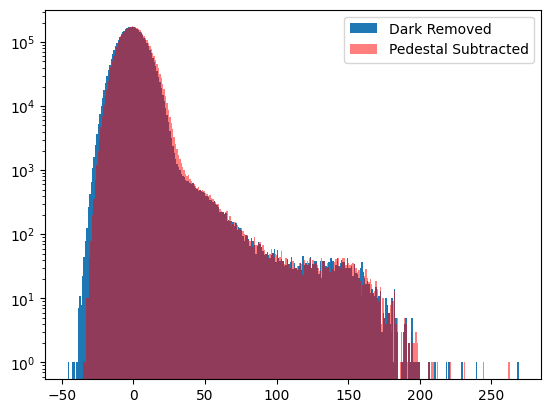

In [9]:
img8 = load_image("data/images/image8.npy")
bin_centres8_dark, hist_data8_dark = make_histogram(img8-master_dark, -1)
plt.bar(bin_centres8_dark, hist_data8_dark, bin_centres8_dark[1]-bin_centres8_dark[0], label = "Dark Removed")


bin_centres8, hist_data8 = make_histogram(img8, -1)
popt = fit_pedestal(bin_centres8, hist_data8)[0]
bin_centres8_pedestal, hist_data8_pedestal = make_histogram(subtract_pedestal(img8, popt), -1)
plt.bar(bin_centres8_pedestal, hist_data8_pedestal, bin_centres8_pedestal[1]-bin_centres8_pedestal[0], alpha=0.5, color="red", label = "Pedestal Subtracted")
plt.legend()
plt.yscale("log")

## What does a single spectrum look like?

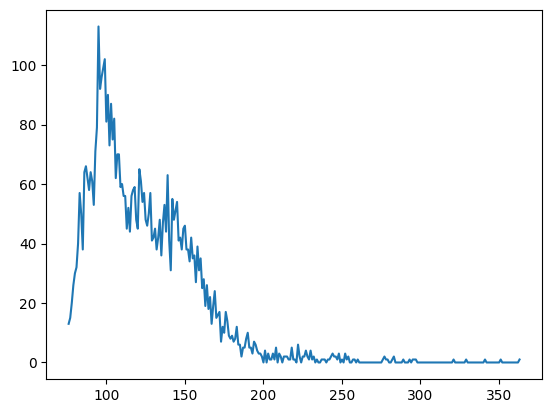

In [20]:
hits = get_img_hit_data(img8-master_dark, 2, 4)
plt.plot(*make_histogram(hits, -1), label = "Primaries and secondaries")

"""hits = get_img_hit_data(img8-master_dark, 2, 4, False, True)
plt.plot(*make_histogram(hits, -1), label = "Primaries only, adjusted")

hits = get_img_hit_data(img8-master_dark, 2, 4, False, False)
plt.plot(*make_histogram(hits, -1), label = "Primaries only, unadjusted")"""

plt.show()

# Questions

- Bragg Spectroscopy
    - **What's the aim of this? What are we really aiming to get out of it?**
    - **Could fit to the Bragg lines in the image, and use histograms from within the lines to determine the pixel values that contribute to the peaks, but can't we just do this using the spectrum?**
- SNR
    - **What is our signal and noise in the final spectrum? How do we determine a SNR?**
- General stuff
    - **Is what I'm doing technical enough? Any suggestions for how I could make this more technical to add stuff to my report?**
    - **Simulation of CCD - is that a good idea?**
    - **What other avenues could I go down?**

statistics of 1vs2vs3 hits
look at single pixel hits, look for several bumps as 1 vs multiple hits (is detector linear?). 2 peaks above should almost certainly not be the two lines. Photon counting nowhere near good resolution

compare histograms on lines, convinve ourselves we don't have resolution required.

Easier to do above w/ single photon counting. SPC gives probability of some number of photons on each pixel

-> image of integers, correspondong to no of photons

Easier to just get probability distribution

SPC maps number of photons to each pixel, bragg maps energy to each pixel: Energy increases across the image.

Uncertainty comes from 
- probability of n photons on a given pixel
- or distribution

So Bragg: aim is for an energy map for each pixel, with uncertainty.

Fig 6 - see slight changes in spectra for different beam energies. Should ideally be able to do better than this.

Steepness of lines in this figure gives spectral resolution.

Why do we do this? Higher resolution features in line reveal things about plasma. Lines aren't particularly interesting.

Robustness check: final algo should not be super dependent on optimisation parameters. If they are, justify why.



# Key insights this week

- All the signal data is integer values. So, in the histogram, we should always make sure: n_bins <= x_max-x_min